In [1]:
from traffic.core import Traffic

In [2]:
import pandas as pd

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [30]:
import altair as alt
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [33]:
from traffic.data import airports

In [27]:
from ground_analysis.utils import within_Xmin
from ground_analysis.extract_flight_info import onehot_runways, assign_twy_occ

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [28]:
from ground_analysis.utils import within_Xmin


# Load

In [4]:
t_5_10=Traffic.from_file('../data/samples/t_5_10_dep_arr.pkl')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [9]:
fdf_dep_path = "../data/intermediate/flight_df_DEP_v27_2019-10-01 03:58:59+00:00_2019-11-30 22:14:59+00:00.pkl"
fdf_dep = pd.read_pickle(fdf_dep_path)

In [14]:
fdf_dep.hh.dt.tz_convert('CET')

0       2019-11-09 12:00:00+01:00
1       2019-10-13 08:00:00+02:00
2       2019-11-01 18:30:00+01:00
3       2019-11-16 14:00:00+01:00
4       2019-10-10 15:30:00+02:00
                   ...           
16453   2019-10-10 14:00:00+02:00
16454   2019-10-18 06:30:00+02:00
16455   2019-11-17 13:30:00+01:00
16456   2019-11-26 13:30:00+01:00
16457   2019-10-02 19:00:00+02:00
Name: hh, Length: 16458, dtype: datetime64[ns, CET]

In [3]:
dep_arr_df = pd.read_pickle('../data/processed/dep_arr_df8_nextavgdelays_fixed.pkl')

In [24]:
twy_cols = [
    "H_occ",
    "K_occ",
    "B_occ",
    "F_occ",
    "L_occ",
    "J_occ",
    "E_occ",
    "D_occ",
    "C_occ",
    "N_occ",
    "A_occ",
    "M_occ",
    "Y_occ",
    "R_occ",
    "G_occ",
    "Z_occ",
    "P_occ",
]
tw_pca_cols = ["twy_pca_0", "twy_pca_1", "twy_pca_2"]
apt_congest_cols = ["nb_arr", "nb_dep", "nb", "hh_num"]
sifi_cols = ["aqli_DEP", "scfi_DEP", "aqli_ARR", "scfi_ARR"]
rwy_cols = ["rwy__10", "rwy__14", "rwy__16", "rwy__28", "rwy__32", "rwy__34"]
taxi_path_cols = ["taxi_dist", "angle_sum"]  # To add if relevant
asma_cols = [
    "nominal",
    "busy",
    "disrupted",
    "not_nom_arrival_ratio",
]
weather_cols = [
    "press",
    "temp",
    "atmap_visibility",
    "atmap_wind",
    "atmap_precipitation",
    "atmap_freezing",
    "atmap_danger",
]
wtc_counts_cols = [
    "H_count",
    "L_count",
    "L/M_count",
    "M_count",
]
wtc_ratios_cols = [
    "H_count_ratio",
    "L_count_ratio",
    "L/M_count_ratio",
    "M_count_ratio",
]
twy_pca_cols = [
    "twy_pca_0",
    "twy_pca_1",
    "twy_pca_2",
]
wtc_one_hot_col = ["H", "L", "L/M", "M"]
turnaround_cols = ["turnaround_minutes"]

all_columns = (
    twy_cols
    + tw_pca_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + turnaround_cols
)


In [31]:
" ".join(dep_arr_df.columns)

'flight_id on_runway_time taxi_holding_time rwy_holding_time total_holding_time taxi_holding_time_minutes first_movement callsign registration typecode icao24 firstseen_min start stop duration cumdist_max parking_position parking_position_duration pb_duration end_pb duration_minutes parking_position_duration_minutes pb_duration_minutes first_movement_start taxi_dist total_holding_time_minutes real_dur real_dur_minutes airline hh hh_num angle_sum avg_speed mvt_type taxiing_stop avg_delay_30min avg_delay_60min turnaround turnaround_minutes NDepDep nominal busy disrupted not_nom_arrival_ratio press temp atmap_visibility atmap_wind atmap_precipitation atmap_freezing atmap_danger atmap_score config nb_arr nb_dep nb icao_wtc H L L/M M H_count L_count L/M_count M_count H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio H_occ K_occ B_occ F_occ L_occ J_occ E_occ D_occ C_occ N_occ A_occ M_occ Y_occ R_occ G_occ Z_occ P_occ twy_pca_0 twy_pca_1 twy_pca_2 aqli_DEP scfi_DEP aqli_ARR scfi_ARR r

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

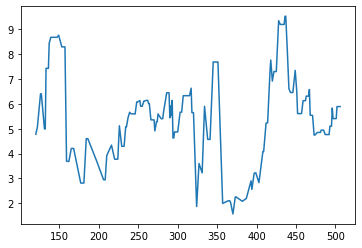

In [46]:
oob_time = pd.Timestamp('2019-10-01 12:19:16+0000')
dt = pd.Timedelta('5H')
t1=oob_time - dt
t2=oob_time + dt
dep_arr_df.query(f'"{t1}"<=first_movement_start<"{t2}" & mvt_type=="DEP"').sort_values('first_movement_start')['avg_delay_in30min'].plot()


In [48]:
datachart = dep_arr_df[['J_occ', 'total_holding_time_minutes', 'avg_delay_30min']]
alt.Chart(datachart).mark_boxplot().encode(x='J_occ:O', y='total_holding_time_minutes')

NameError: name 'alt' is not defined

In [53]:
dep_arr_df.query('mvt_type == "DEP" & end_pb==end_pb')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,aqli_DEP,scfi_DEP,aqli_ARR,scfi_ARR,rwy__10,rwy__14,rwy__16,rwy__28,rwy__32,rwy__34
1,EDW200_5718,2019-10-01 04:10:37+00:00,0 days 00:01:18,None,0 days 00:04:56,1.300000,2019-10-01 04:03:36+00:00,EDW200,HB-IHZ,A320,...,0.0,0.0,3.0,3.0,0,0,0,0,1,0
10,EDW77D_14374,2019-10-01 04:24:56+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:21:26+00:00,EDW77D,HB-JLR,A320,...,0.0,1.0,2.0,2.0,0,0,0,0,1,0
12,EDW15T_7910,2019-10-01 04:31:56+00:00,0 days 00:01:03,None,0 days 00:05:26,1.050000,2019-10-01 04:23:56+00:00,EDW15T,HB-IJV,A320,...,1.0,3.0,1.0,2.0,0,0,0,0,1,0
14,EDW214_7815,2019-10-01 04:35:11+00:00,0 days 00:03:12,None,0 days 00:07:35,3.200000,2019-10-01 04:25:56+00:00,EDW214,HB-IJU,A320,...,2.0,3.0,3.0,3.0,0,0,0,0,1,0
18,TAP929_5192,2019-10-01 04:41:09+00:00,0 days 00:02:25,None,0 days 00:02:26,2.416667,2019-10-01 04:33:31+00:00,TAP929,CS-TTF,A319,...,1.0,1.0,1.0,1.0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36001,UAE86_20078,2019-11-30 21:40:23+00:00,0 days 00:03:08,None,0 days 00:11:14,3.133333,2019-11-30 21:27:01+00:00,UAE86,A6-EEN,A388,...,2.0,3.0,1.0,1.0,0,0,0,0,1,0
36002,SWR80KF_10610,2019-11-30 21:34:35+00:00,0 days 00:00:00,None,0 days 00:04:41,0.000000,2019-11-30 21:28:16+00:00,SWR80KF,HB-JBF,BCS1,...,0.0,2.0,0.0,0.0,0,0,0,0,1,0
36003,SWR256_9233,2019-11-30 21:40:36+00:00,0 days 00:00:00,None,0 days 00:04:38,0.000000,2019-11-30 21:33:56+00:00,SWR256,HB-ION,A321,...,2.0,2.0,1.0,1.0,0,0,0,0,0,1
36005,SWR176_15653,2019-11-30 22:02:47+00:00,0 days 00:02:16,None,0 days 00:15:41,2.266667,2019-11-30 21:44:51+00:00,SWR176,HB-JNJ,B77W,...,1.0,2.0,1.0,1.0,0,1,0,0,0,0


# on avg speed and max turnaronuds

In [69]:
avg_avg_speed_df = dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position & avg_speed==avg_speed').sort_values('first_movement_start').set_index('first_movement_start').rolling('30T').agg({'avg_speed':'mean'}).rename(columns={'avg_speed':'avg_speed_last30min'})

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

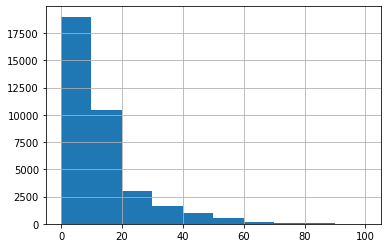

In [100]:
dep_arr_df.avg_speed.hist(range = [0,100])

<AxesSubplot:>

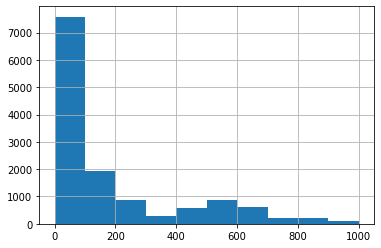

In [86]:
dep_arr_df.query("turnaround_minutes>0").turnaround_minutes.hist(range=(0,1000))

<AxesSubplot:>

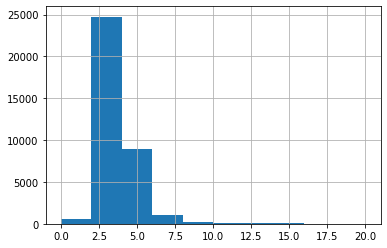

In [91]:
df.avg_speed_last30min.hist(range=[0,20])

In [92]:
df = pd.merge_asof(dep_arr_df, avg_avg_speed_df.query("avg_speed_last30min<10"), left_on='first_movement_start', right_index=True)

In [84]:
def assign_avg_dep_speed(dep_arr_df, dt_str = '30T', speed_col="avg_speed", tolerance=pd.Timedelta('2T')):
    dep_arr_df_filtered=dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position & avg_speed==avg_speed')
    new_col = f'{speed_col}_last{dt_str}'
    avg_avg_speed_df = dep_arr_df_filtered.sort_values('first_movement_start').set_index('first_movement_start').rolling(dt_str).agg({speed_col:'mean'}).rename(columns={speed_col:new_col})
    return pd.merge_asof(dep_arr_df.sort_values('first_movement_start'), avg_avg_speed_df.query(f"{new_col}<10"), left_on='first_movement_start', right_index=True, tolerance=tolerance)

def assign_max_turnaround(dep_arr_df, dt_str = '30T', tolerance=pd.Timedelta('2T')):
    dep_arr_df_filtered=dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position & turnaround<"8h"')
    max_turnaround_df = dep_arr_df_filtered.sort_values('first_movement_start').set_index('first_movement_start').rolling(dt_str).agg({'turnaround_minutes':'max'}).rename(columns={'turnaround_minutes':f'max_turnaround_minutes_last{dt_str}'})
    return pd.merge_asof(dep_arr_df.sort_values('first_movement_start'), max_turnaround_df, left_on='first_movement_start', right_index=True, tolerance=tolerance)


/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [85]:
full_dep_df = dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position')

In [86]:
t = assign_max_turnaround(dep_arr_df)

In [91]:
dep_df=dep_arr_df.query('mvt_type=="DEP"')

In [92]:
dep_arr_df_filtered=dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position & turnaround<"8h"')
max_turnaround_df = dep_arr_df_filtered.sort_values('first_movement_start').set_index('first_movement_start').rolling("30T").agg({'turnaround_minutes':'max'}).rename(columns={'turnaround_minutes':f'max_turnaround_minutes_last30T'})

In [93]:
tolerance = pd.Timedelta('2T')
temp = pd.merge_asof(dep_df.sort_values('first_movement_start'), max_turnaround_df, left_on='first_movement_start', right_index=True, tolerance=tolerance)

In [94]:
temp[['flight_id','max_turnaround_minutes_last30T']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16932 entries, 0 to 36009
Data columns (total 2 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   flight_id                       16932 non-null  object 
 1   max_turnaround_minutes_last30T  7332 non-null   float64
dtypes: float64(1), object(1)
memory usage: 396.8+ KB


In [70]:
t[['flight_id', 'max_turnaround_minutes_last30T']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36010 entries, 0 to 36009
Data columns (total 2 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   flight_id                       36010 non-null  object 
 1   max_turnaround_minutes_last30T  35920 non-null  float64
dtypes: float64(1), object(1)
memory usage: 844.0+ KB


<AxesSubplot:>

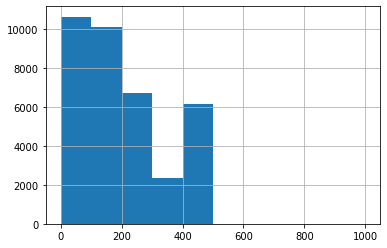

In [52]:
t.max_turnaround_minutes_last30T.hist(range=(0,1000))

In [56]:
t.avg_delay_30min.isna().sum()

19196

In [46]:
datachart=t.query("max_turnaround_minutes_last30T==max_turnaround_minutes_last30T")[['max_turnaround_minutes_last30T', 'avg_delay_30min', 'total_holding_time_minutes']]
alt.Chart(datachart).mark_boxplot().encode(alt.X('max_turnaround_minutes_last30T', bin=True), alt.Y('avg_delay_30min'))

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [6]:
datachart = dep_arr_df.query("avg_speed<40")[['avg_speed','total_holding_time_minutes', 'avg_delay_30min']]
alt.Chart(datachart).mark_bar().encode(x=alt.X('avg_speed:Q', bin=alt.Bin(maxbins=20)), y='mean(total_holding_time_minutes):Q', color='count()')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [95]:
datachart = df[['total_holding_time_minutes', 'avg_delay_30min', 'avg_speed_last30min']]
alt.Chart(datachart).mark_bar().encode(x=alt.X('avg_speed_last30min', bin=True), y='mean(total_holding_time_minutes)', color='count()')

alt.Chart(...)

In [96]:
datachart = df[['total_holding_time_minutes', 'avg_delay_30min', 'avg_speed_last30min']]
alt.Chart(datachart).mark_boxplot().encode(x=alt.X('avg_speed_last30min', bin=True), y=alt.Y('avg_delay_30min'))

alt.Chart(...)

In [95]:
" ".join(dep_arr_df.columns)

'flight_id on_runway_time taxi_holding_time rwy_holding_time total_holding_time taxi_holding_time_minutes first_movement callsign registration typecode icao24 firstseen_min start stop duration cumdist_max parking_position parking_position_duration pb_duration end_pb duration_minutes parking_position_duration_minutes pb_duration_minutes first_movement_start taxi_dist total_holding_time_minutes real_dur real_dur_minutes airline hh hh_num angle_sum avg_speed mvt_type taxiing_stop avg_delay_30min avg_delay_in30min avg_delay_in60min turnaround turnaround_minutes NDepDep nominal busy disrupted not_nom_arrival_ratio press temp atmap_visibility atmap_wind atmap_precipitation atmap_freezing atmap_danger atmap_score config nb_arr nb_dep nb icao_wtc H L L/M M H_count L_count L/M_count M_count H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio H_occ K_occ B_occ F_occ L_occ J_occ E_occ D_occ C_occ N_occ A_occ M_occ Y_occ R_occ G_occ Z_occ P_occ twy_pca_0 twy_pca_1 twy_pca_2 aqli_DEP scfi_DEP

In [ ]:
['aqli_DEP' , 'scfi_DEP' , 'aqli_ARR' , 'scfi_ARR' ]

In [ ]:
def 

In [97]:
dt_str = "30T"
dep_arr_df_filtered=dep_arr_df.query('mvt_type=="DEP"')
max_turnaround_df = dep_arr_df_filtered.sort_values('first_movement_start').set_index('first_movement_start').rolling(dt_str).agg({'scfi_DEP':'mean'}).rename(columns={'scfi_DEP':f'mean_scfi_DEP_last{dt_str}'})
t = pd.merge_asof(dep_arr_df.sort_values('first_movement_start'), max_turnaround_df, left_on='first_movement_start', right_index=True, tolerance=tolerance)


In [98]:
t.mean_scfi_DEP_last30T

0        0.000000
1        0.000000
2             NaN
3             NaN
4             NaN
           ...   
36005    1.800000
36006    1.500000
36007         NaN
36008    1.428571
36009    0.750000
Name: mean_scfi_DEP_last30T, Length: 36010, dtype: float64

# mean sifis

In [101]:
datachart = t.query('mvt_type=="DEP"')[['mean_scfi_DEP_last30T', 'avg_delay_in30min', 'avg_delay_in60min']]
alt.Chart(datachart).mark_boxplot().encode(alt.X('mean_scfi_DEP_last30T',bin=True), alt.Y('avg_delay_in30min'))

alt.Chart(...)

In [124]:
def assign_mean_sifis(dep_arr_df, sifi_cols, dt_str = '30T', tolerance=pd.Timedelta('2T')):
    for col in sifi_cols:
        dep_arr_df_filtered=dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position')
        max_turnaround_df = dep_arr_df_filtered.sort_values('first_movement_start').set_index('first_movement_start').rolling(dt_str, closed = 'left').agg({col:'mean'}).rename(columns={col:f'mean_{col}_last{dt_str}'})
        dep_arr_df= pd.merge_asof(dep_arr_df.sort_values('first_movement_start'), max_turnaround_df, left_on='first_movement_start', right_index=True, tolerance=tolerance)
    return dep_arr_df

In [125]:
t = assign_mean_sifis(dep_arr_df, sifi_cols)

In [106]:
avg_sifi_cols = [f'mean_{col}_last30T' for col in sifi_cols]

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [111]:
avg_sifi_cols

['mean_NDepDep_last30T',
 'mean_aqli_DEP_last30T',
 'mean_scfi_DEP_last30T',
 'mean_aqli_ARR_last30T',
 'mean_scfi_ARR_last30T']

In [126]:
t[['flight_id']+avg_sifi_cols+sifi_cols].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36010 entries, 0 to 36009
Data columns (total 11 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   flight_id              36010 non-null  object 
 1   mean_NDepDep_last30T   12331 non-null  float64
 2   mean_aqli_DEP_last30T  12560 non-null  float64
 3   mean_scfi_DEP_last30T  12560 non-null  float64
 4   mean_aqli_ARR_last30T  12560 non-null  float64
 5   mean_scfi_ARR_last30T  12560 non-null  float64
 6   NDepDep                6304 non-null   float64
 7   aqli_DEP               36010 non-null  float64
 8   scfi_DEP               36010 non-null  float64
 9   aqli_ARR               36010 non-null  float64
 10  scfi_ARR               36010 non-null  float64
dtypes: float64(10), object(1)
memory usage: 3.3+ MB


In [138]:
datachart = t.query('first_movement_start.dt.day==5 & first_movement_start.dt.month==10')[['first_movement_start', 'NDepDep']].sort_values('first_movement_start').fillna(method='backfill')
alt.Chart(datachart).mark_line().encode(x='first_movement_start:T', y='NDepDep')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [130]:
avg_sifi_cols

['mean_NDepDep_last30T',
 'mean_aqli_DEP_last30T',
 'mean_scfi_DEP_last30T',
 'mean_aqli_ARR_last30T',
 'mean_scfi_ARR_last30T']

In [131]:
datachart = t.query('mvt_type=="DEP"')[['total_holding_time_minutes', 'avg_delay_30min', 'avg_delay_in30min', 'avg_delay_in60min'] + avg_sifi_cols]
alt.Chart(datachart).transform_fold(avg_sifi_cols[:3]).mark_boxplot(outliers=False).encode(alt.X('value:Q', bin=True), alt.Y('avg_delay_in30min:Q'), facet='key:N')

alt.Chart(...)

In [127]:
temp = t.assign(sifidif = lambda x: (x.mean_aqli_DEP_last30T - x.aqli_DEP).abs())

In [128]:
temp.sifidif.describe()

count    12560.000000
mean         2.225624
std          1.800146
min          0.000000
25%          1.000000
50%          2.000000
75%          3.200000
max         29.000000
Name: sifidif, dtype: float64

In [134]:
dep_arr_df.query("end_pb!=end_pb & parking_position==parking_position & mvt_type=='DEP'")

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,aqli_DEP,scfi_DEP,aqli_ARR,scfi_ARR,rwy__10,rwy__14,rwy__16,rwy__28,rwy__32,rwy__34
29,EDW130_5511,2019-10-01 05:04:11+00:00,0 days 00:08:37,None,0 days 00:08:37,8.616667,2019-10-01 04:54:11+00:00,EDW130,HB-IHX,A320,...,0.0,0.0,0.0,0.0,0,0,0,0,1,0
31,SWR914_17427,2019-10-01 05:04:57+00:00,0 days 00:00:59,None,0 days 00:00:59,0.983333,2019-10-01 04:57:01+00:00,SWR914,None,None,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
67,SWR63U_7475,2019-10-01 05:56:46+00:00,0 days 00:04:02,None,0 days 00:04:02,4.033333,2019-10-01 05:50:26+00:00,SWR63U,HB-IJQ,A320,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
69,SWR786_14674,2019-10-01 06:06:02+00:00,0 days 00:09:24,None,0 days 00:09:24,9.400000,2019-10-01 05:52:31+00:00,SWR786,HB-JLS,A320,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
80,N17RX_20236,2019-10-01 06:11:45+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 06:05:21+00:00,N17RX,None,None,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35831,TAR701_059,2019-11-30 12:49:08+00:00,0 days 00:07:31,None,0 days 00:07:31,7.516667,2019-11-30 12:38:51+00:00,TAR701,TS-IMR,A320,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
35832,TAR701_059,2019-11-30 12:49:08+00:00,0 days 00:07:31,None,0 days 00:07:31,7.516667,2019-11-30 12:38:51+00:00,TAR701,TS-IMR,A320,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
35917,GSW6040_15974,2019-11-30 16:28:56+00:00,0 days 00:01:23,None,0 days 00:01:23,1.383333,2019-11-30 16:23:21+00:00,GSW6040,None,None,...,0.0,0.0,0.0,0.0,0,0,0,1,0,0
35941,SWR180_15527,2019-11-30 17:24:31+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-11-30 17:19:16+00:00,SWR180,HB-JNG,B77W,...,0.0,0.0,0.0,0.0,0,0,1,0,0,0
